In [21]:
# get evaluatin table for README

table_path = "results\\tracker\\27-04-2022_16-25\\tracker_evaluation_MOT16-mini.csv"
import pandas as pd
df = pd.read_csv(table_path)
show_metrics = ["idf1", "idp", "idr", "recall", "precision", "mota", "motp"]
print(df.set_index("Unnamed: 0").loc[:, show_metrics].to_markdown())

|    | Unnamed: 0    |   idf1 |   idp |   idr |   recall |   precision |   num_unique_objects |   mostly_tracked |   partially_tracked |   mostly_lost |   num_false_positives |   num_misses |   num_switches |   num_fragmentations |   mota |   motp |
|---:|:--------------|-------:|------:|------:|---------:|------------:|---------------------:|-----------------:|--------------------:|--------------:|----------------------:|-------------:|---------------:|---------------------:|-------:|-------:|
|  0 | MOT16-02-mini |   0.57 |  0.63 |  0.52 |     0.53 |        0.64 |                   23 |                8 |                   6 |             9 |                   135 |          213 |              1 |                    7 |   0.22 |   0.26 |
|  1 | OVERALL       |   0.57 |  0.63 |  0.52 |     0.53 |        0.64 |                   23 |                8 |                   6 |             9 |                   135 |          213 |              1 |                    7 |   0.22 |   0.26 |


(<Figure size 1440x1440 with 1 Axes>, <AxesSubplot:>)

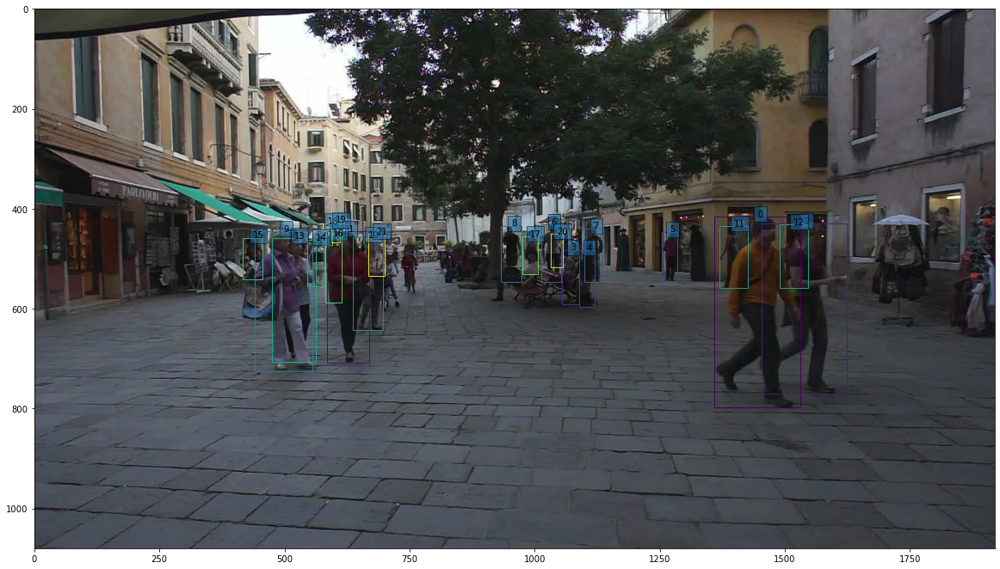

In [61]:
from src.detector.visualize import visualize_detection, visualize_tracker
frame = sequence[5]
visualize_detection(frame["img"], frame["gt"].values())

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (1130, 642) to (1136, 656) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


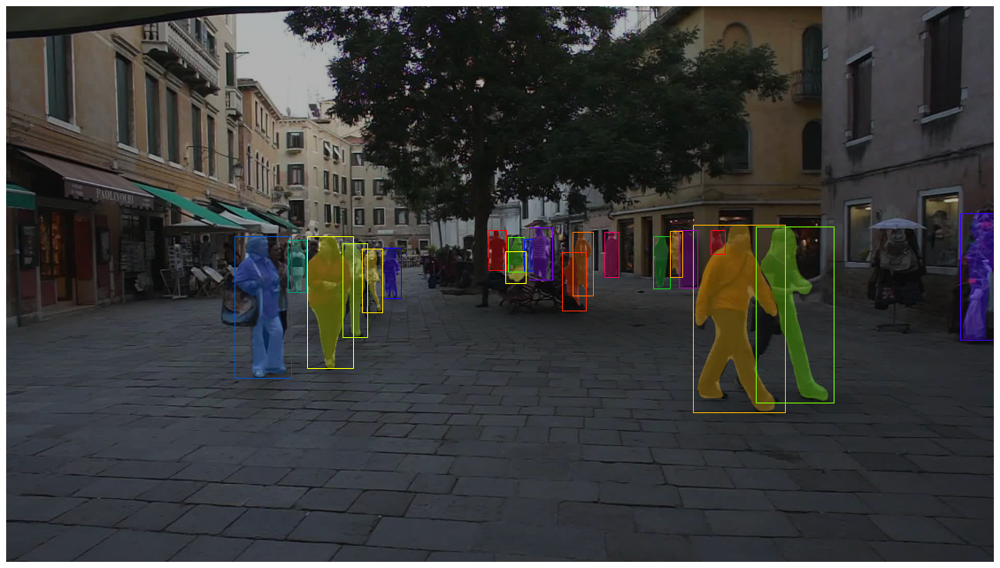

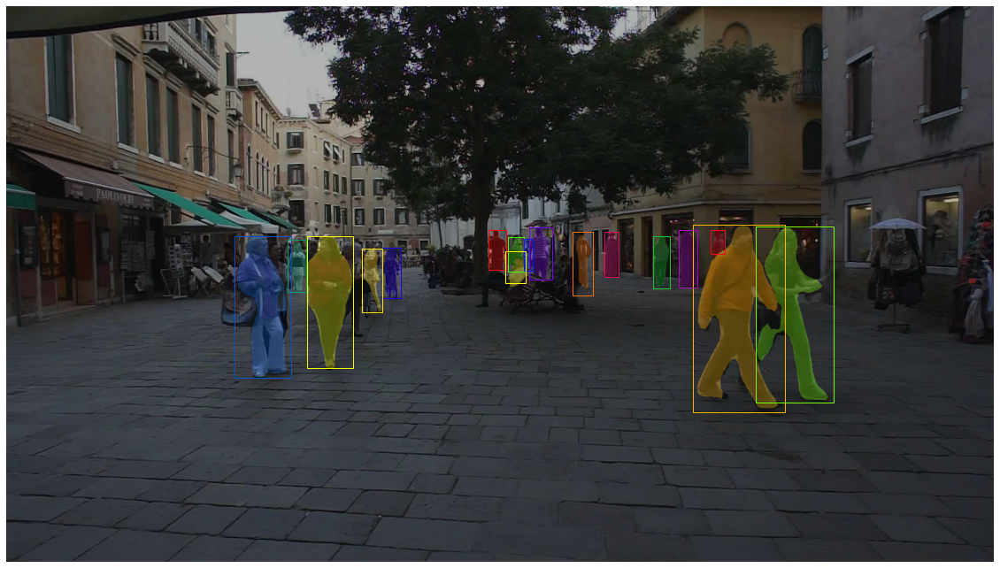

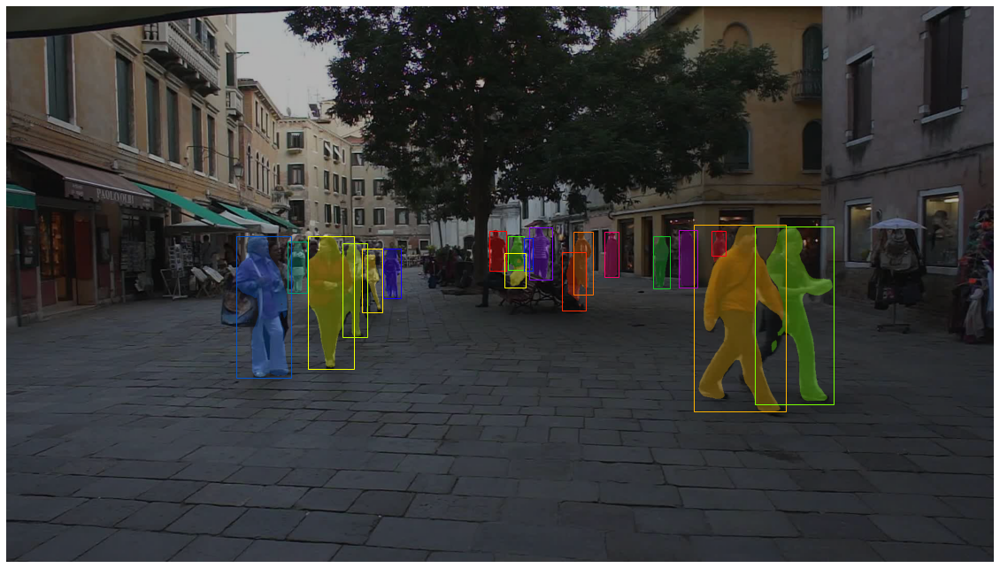

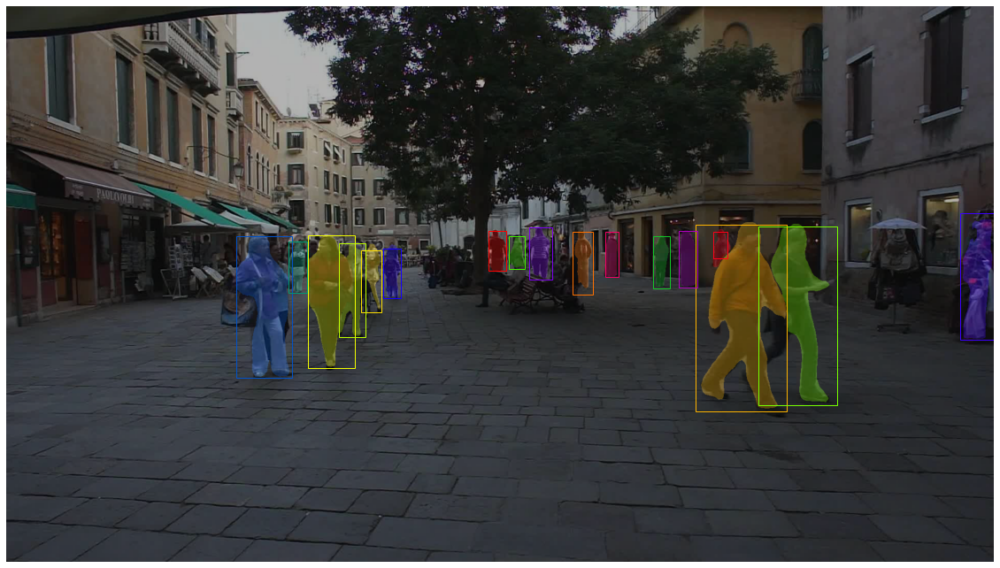

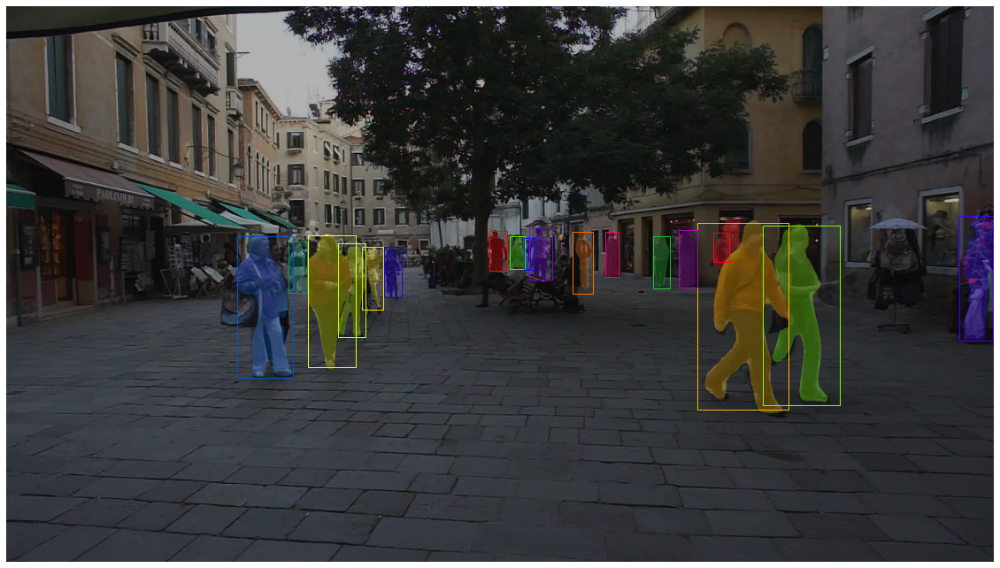

...

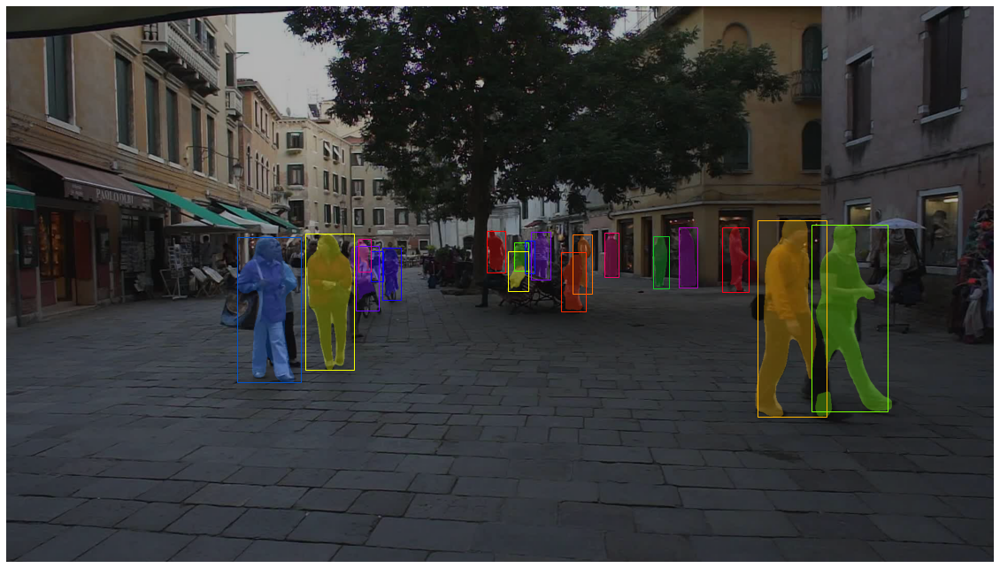

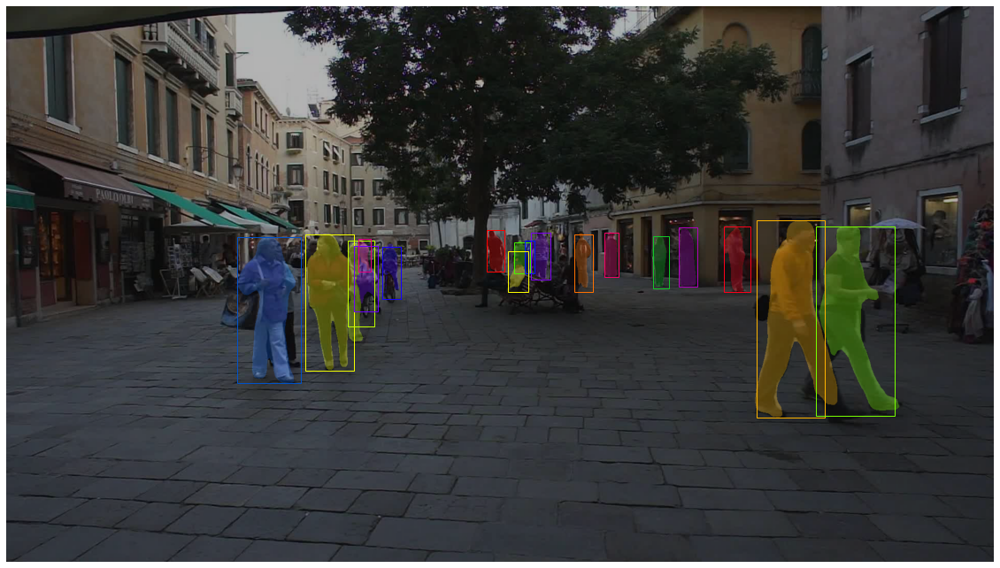

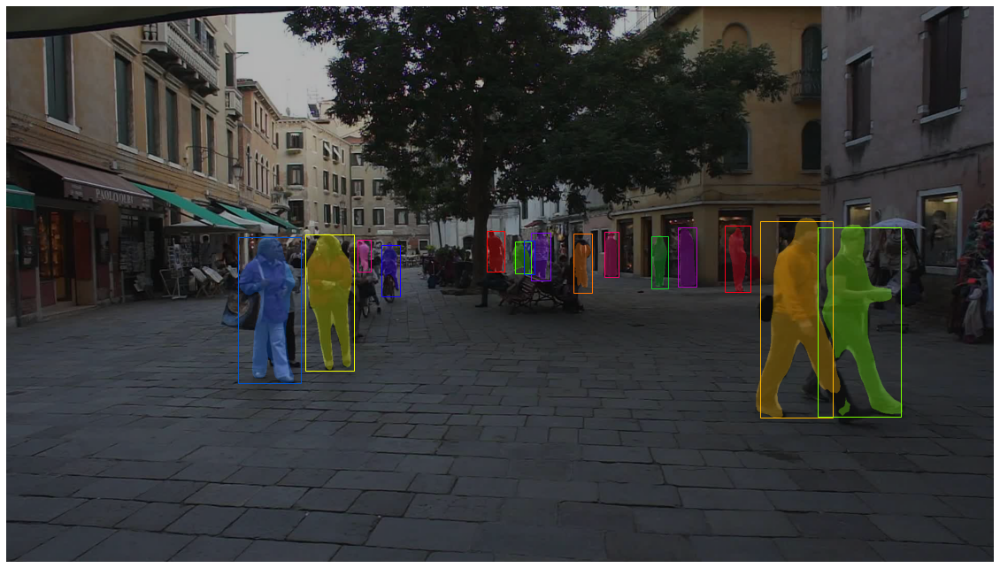

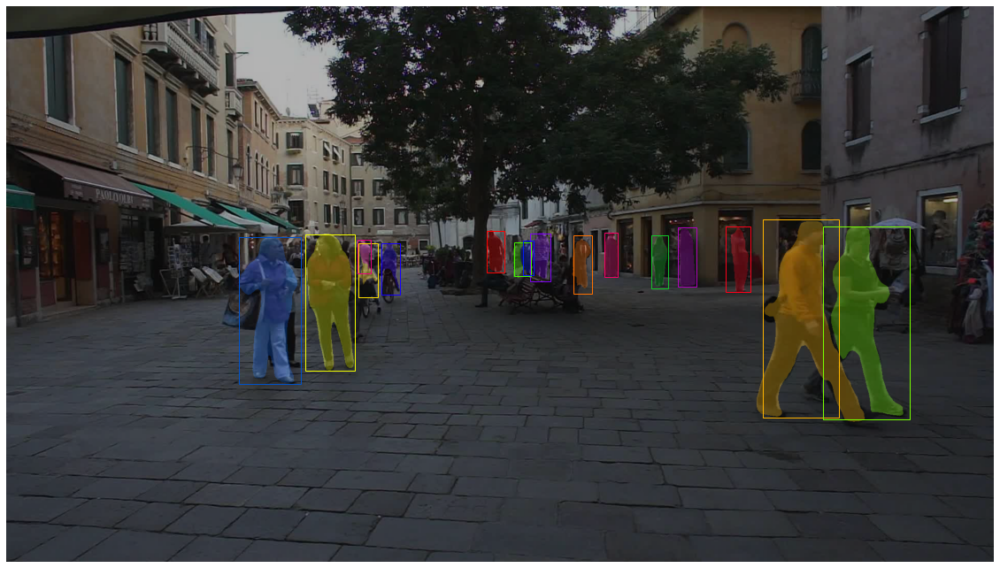

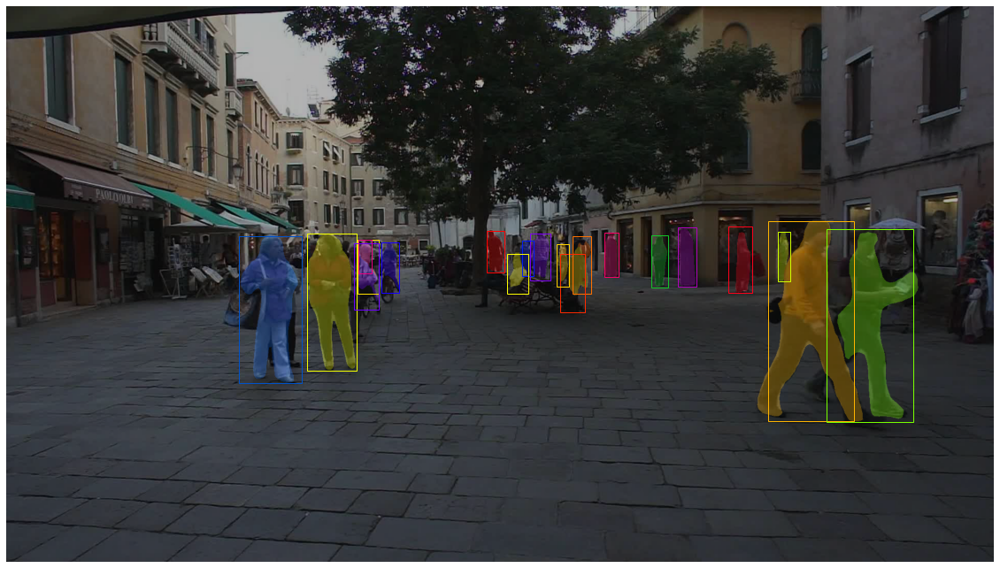

In [45]:
import os
import matplotlib.pyplot as plt
from src.utils.file_utils import ensure_dir
import imageio
from tqdm.notebook import tqdm
from src.detector.data_utils import load_detection_from_txt
from src.detector.visualize import visualize_detection, visualize_tracker
from src.tracker.data_track_precomputed import MOT16SequencesPrecomputed

tracker_path = "results\\tracker\\28-04-2022_00-31\\MOT16-02-mini\\track.txt"
track = load_detection_from_txt(tracker_path, mode="track")

dataset = MOT16SequencesPrecomputed(
    precomputed_data_root_dir="data\precomputed_detection\coco_maskrcnn_recall",
    original_data_root_dir="data/MOT16",
    split="mini",
    return_det_segmentation=True
)

sequence = dataset[0]


output_dir = "video"
for frame_id, frame in enumerate(sequence, start=1):
    if frame_id == 100:
        break
    img = frame["img"]
    masks = frame["masks"]
    boxes = track["boxes"][frame_id]

    # fig, ax = visualize_detector(
    #     img=img, 
    #     boxes=list(track["boxes"][frame_id].values()), 
    #     #masks=masks, 
    # );
    
    confident = frame["scores"] > 0.5
    fig, ax = visualize_tracker(
        img=img, 
        boxes=boxes, 
        masks=masks[confident], 
    );
    
    
    file_name = f"{frame_id:06d}.png"
    output_path = os.path.join(output_dir, file_name)
    ensure_dir(output_path)
    ax.axis("off");
    fig.savefig(output_path, bbox_inches='tight');

writer = imageio.get_writer('test.mp4', fps=25)
for img_file in os.listdir(output_dir):
    img_path = os.path.join(output_dir, img_file)
    writer.append_data(imageio.imread(img_path))
writer.close()
    

In [6]:
# from src.detector.utils import binary_mask_iou
# from scipy.optimize import linear_sum_assignment
# import torch

# for frame_id in range(1, len(sequence)):
#     prev_frame = sequence[frame_id-1] 
#     frame = sequence[frame_id]
#     iou = binary_mask_iou(boxes1=prev_frame["boxes"], boxes2=frame["boxes"], masks1=prev_frame["masks"], masks2=frame["masks"])
#     cost = 
#     iou = torch.where(iou > 0.75, iou, 255)
#     linear_sum_assignment(iou, maximize)